# 1.Import libraries and load dataset

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import datetime
import seaborn as sns

In [ ]:
import warnings
warnings.filterwarnings('ignore')

In [ ]:
df = pd.read_excel("ANZ synthesised transaction dataset.xlsx")
df.head()

,status,card_present_flag,bpay_biller_code,account,currency,long_lat,txn_description,merchant_id,merchant_code,first_name,...,age,merchant_suburb,merchant_state,extraction,amount,transaction_id,country,customer_id,merchant_long_lat,movement
0,authorized,1.0,NaN,ACC-1598451071,AUD,153.41 -27.95,POS,81c48296-73be-44a7-befa-d053f48ce7cd,NaN,Diana,...,26,Ashmore,QLD,2018-08-01T01:01:15.000+0000,16.25,a623070bfead4541a6b0fff8a09e706c,Australia,CUS-2487424745,153.38 -27.99,debit
1,authorized,0.0,NaN,ACC-1598451071,AUD,153.41 -27.95,SALES-POS,830a451c-316e-4a6a-bf25-e37caedca49e,NaN,Diana,...,26,Sydney,NSW,2018-08-01T01:13:45.000+0000,14.19,13270a2a902145da9db4c951e04b51b9,Australia,CUS-2487424745,151.21 -33.87,debit
2,authorized,1.0,NaN,ACC-1222300524,AUD,151.23 -33.94,POS,835c231d-8cdf-4e96-859d-e9d571760cf0,NaN,Michael,...,38,Sydney,NSW,2018-08-01T01:26:15.000+0000,6.42,feb79e7ecd7048a5a36ec889d1a94270,Australia,CUS-2142601169,151.21 -33.87,debit
3,authorized,1.0,NaN,ACC-1037050564,AUD,153.10 -27.66,SALES-POS,48514682-c78a-4a88-b0da-2d6302e64673,NaN,Rhonda,...,40,Buderim,QLD,2018-08-01T01:38:45.000+0000,40.90,2698170da3704fd981b15e64a006079e,Australia,CUS-1614226872,153.05 -26.68,debit
4,authorized,1.0,NaN,ACC-1598451071,AUD,153.41 -27.95,SALES-POS,b4e02c10-0852-4273-b8fd-7b3395e32eb0,NaN,Diana,...,26,Mermaid Beach,QLD,2018-08-01T01:51:15.000+0000,3.25,329adf79878c4cf0aeb4188b4691c266,Australia,CUS-2487424745,153.44 -28.06,debit


# 2.Data Preparation and Basic Checks

The process includes checking and reformatting the information so it’s consistent, removing duplicates, merging disparate sources, and filtering out unneeded “noise” in datasets.

In [ ]:
# check the shape of the DataFrame
df.shape

(12043, 23)

From the above observation we confirm that the dataset contains and 12043 transactions and 23 features.

In [ ]:
# confirmation of existing columns of file on load
pd.DataFrame({"Columns": df.columns})

,Columns
0,status
1,card_present_flag
2,bpay_biller_code
3,account
4,currency
5,long_lat
6,txn_description
7,merchant_id
8,merchant_code
9,first_name


# 2.1 Unique customers, unique transactions and 3 months of data checks

Before we explore explore each column individually, let's check for the following:

•	100 unique customers (customer_id) 

•	Each row corresponds to a unique transaction ID (transaction_id) 

•	3 months worth of data (date)


In [ ]:
print("Number of unique customer ID's: ", 
      df.customer_id.nunique())

Number of unique customer ID's:  100


In [ ]:
#confirm the one-to-one link of account_id and customer_id

#create new column concat customer id and account id
df['cust_id_acc_id_compiled'] = df['account'] + "-" + df['customer_id']
df.head()
#check unique account
print(len(df['cust_id_acc_id_compiled'].unique()))
#the length return to be 100, which means there are 100 unique combination of cust_id and acc_id
#if more than one customers have different acc, the combination will exceed 100

100


In [ ]:
print("Number of rows in dataset: ", len(df))
print("Number of unique transaction ID's: ", df.transaction_id.nunique())

Number of rows in dataset:  12043
Number of unique transaction ID's:  12043


In [ ]:
df.date.describe()

count                   12043
unique                     91
top       2018-09-28 00:00:00
freq                      174
first     2018-08-01 00:00:00
last      2018-10-31 00:00:00
Name: date, dtype: object



* The dataset spans starting from 1/8/2018 to 31/10/2018. This should include all 92 days. However, our dataset as 91 transactions only, suggesting 1 day of missing data

In [ ]:

pd.date_range(start = "2018-08-01", end = "2018-10-31").difference(df.date)

DatetimeIndex(['2018-08-16'], dtype='datetime64[ns]', freq=None)

We have one missing date on 16/8/2018.

# 2.2 Non-null count and data types

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12043 entries, 0 to 12042
Data columns (total 24 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   status                   12043 non-null  object        
 1   card_present_flag        7717 non-null   float64       
 2   bpay_biller_code         885 non-null    object        
 3   account                  12043 non-null  object        
 4   currency                 12043 non-null  object        
 5   long_lat                 12043 non-null  object        
 6   txn_description          12043 non-null  object        
 7   merchant_id              7717 non-null   object        
 8   merchant_code            883 non-null    float64       
 9   first_name               12043 non-null  object        
 10  balance                  12043 non-null  float64       
 11  date                     12043 non-null  datetime64[ns]
 12  gender                   12043 n

The info function provides information about the data types and presence of missing values in each column of the dataset.

# 2.3 Missing values

In [ ]:

missing = df.isnull().sum()
missing = missing[missing > 0]
missing_percentage = round(missing / len(df), 3) * 100
pd.DataFrame({"Number of missing values": missing, "Percentage": missing_percentage}).sort_values(by = "Percentage", ascending = False)

,Number of missing values,Percentage
bpay_biller_code,11158,92.7
merchant_code,11160,92.7
card_present_flag,4326,35.9
merchant_id,4326,35.9
merchant_suburb,4326,35.9
merchant_state,4326,35.9
merchant_long_lat,4326,35.9


In [ ]:
#Checking the percentage of missing values
percent_missing = df.isnull().sum() * 100 / len(df)
percent_missing

status                      0.000000
card_present_flag          35.921282
bpay_biller_code           92.651333
account                     0.000000
currency                    0.000000
long_lat                    0.000000
txn_description             0.000000
merchant_id                35.921282
merchant_code              92.667940
first_name                  0.000000
balance                     0.000000
date                        0.000000
gender                      0.000000
age                         0.000000
merchant_suburb            35.921282
merchant_state             35.921282
extraction                  0.000000
amount                      0.000000
transaction_id              0.000000
country                     0.000000
customer_id                 0.000000
merchant_long_lat          35.921282
movement                    0.000000
cust_id_acc_id_compiled     0.000000
dtype: float64


  Both bpay_biller_code and merchant_code columns contain a significant number of missing values. We will deal with those missing values later.

Let's examine the summary statistics of the numerical columns in the dataset.

In [ ]:
#checking for duplicated values
df.duplicated().sum() 

0

In [ ]:
#checking for unique values
df.nunique()

status                         2
card_present_flag              2
bpay_biller_code               3
account                      100
currency                       1
long_lat                     100
txn_description                6
merchant_id                 5725
merchant_code                  1
first_name                    80
balance                    12006
date                          91
gender                         2
age                           33
merchant_suburb             1609
merchant_state                 8
extraction                  9442
amount                      4457
transaction_id             12043
country                        1
customer_id                  100
merchant_long_lat           2703
movement                       2
cust_id_acc_id_compiled      100
dtype: int64

In [ ]:
#dropping the columns
df=df.drop(['bpay_biller_code', 'merchant_code'], axis = 1)

Dropping these two columns as they have approximately 92% of the data missing.

# 2.3 Missing Value Treatment

In [ ]:

#using mode imputation
df['card_present_flag']=df['card_present_flag'].fillna(df['card_present_flag'].mode()[0])
df['merchant_id']=df['merchant_id'].fillna(df['merchant_id'].mode()[0])
df['merchant_suburb']=df['merchant_suburb'].fillna(df['merchant_suburb'].mode()[0])
df['merchant_state']=df['merchant_state'].fillna(df['merchant_state'].mode()[0])
df['merchant_long_lat']=df['merchant_long_lat'].fillna(df['merchant_long_lat'].mode()[0])

In [ ]:
df.isnull().sum()

status                     0
card_present_flag          0
account                    0
currency                   0
long_lat                   0
txn_description            0
merchant_id                0
first_name                 0
balance                    0
date                       0
gender                     0
age                        0
merchant_suburb            0
merchant_state             0
extraction                 0
amount                     0
transaction_id             0
country                    0
customer_id                0
merchant_long_lat          0
movement                   0
cust_id_acc_id_compiled    0
dtype: int64

Now there are no missing values

In [125]:
df.describe()

,card_present_flag,balance,age,amount,consumer_longitude,consumer_latitude,merchant_longitude,merchant_latitude,avg_vol,distance(km)
count,12043.000000,12043.000000,12043.000000,12043.000000,12043.000000,12043.000000,12043.000000,12043.000000,12043.000000,12043.000000
mean,0.873536,14704.195553,30.582330,187.933588,143.648563,-38.164347,146.226776,-33.154017,135.599851,771.328703
std,0.332385,31503.722652,10.046343,592.599934,16.669352,54.622791,10.372136,4.262286,20.276077,1426.321030
min,0.000000,0.240000,18.000000,0.100000,114.620000,-573.000000,113.830000,-43.310000,89.000000,0.000000
25%,1.000000,3158.585000,22.000000,16.000000,138.690000,-37.700000,145.040000,-33.950000,118.000000,17.863165
50%,1.000000,6432.010000,28.000000,29.000000,145.230000,-33.890000,151.210000,-33.870000,139.000000,86.030501
75%,1.000000,12465.945000,38.000000,53.655000,151.220000,-30.750000,151.210000,-32.325000,152.000000,729.059372
max,1.000000,267128.520000,78.000000,8835.980000,255.000000,-12.370000,153.610000,-12.330000,174.000000,10890.446460


The describe function is a good way to observe any anomalies in the numerical 
columns for example, we can check if the age and amount columns contain any negative values, or if a customer has an age of 150 etc. Here, I do not see any anomalies.




In [126]:
#create new dataframe with split value columns
long_lat = df['long_lat'].str.split(" ", n=1, expand=True) 
long_lat.head()
#create new column to add to the anz dataframe from new created dataframe
df['consumer_longitude'] = long_lat[0] 
df['consumer_latitude'] = long_lat[1]
df.head()

,status,card_present_flag,account,currency,long_lat,txn_description,merchant_id,first_name,balance,date,...,consumer_longitude,consumer_latitude,merchant_longitude,merchant_latitude,Weekday,avg_vol,extraction_time,hour,distance(km),category
0,authorized,1.0,ACC-1598451071,AUD,153.41 -27.95,POS,81c48296-73be-44a7-befa-d053f48ce7cd,Diana,35.39,2018-08-01,...,153.41,-27.95,153.38,-27.99,Wednesday,137,2018-08-01 01:01:15,01,5.331721,Purchase
1,authorized,0.0,ACC-1598451071,AUD,153.41 -27.95,SALES-POS,830a451c-316e-4a6a-bf25-e37caedca49e,Diana,21.20,2018-08-01,...,153.41,-27.95,151.21,-33.87,Wednesday,137,2018-08-01 01:13:45,01,690.430719,Purchase
2,authorized,1.0,ACC-1222300524,AUD,151.23 -33.94,POS,835c231d-8cdf-4e96-859d-e9d571760cf0,Michael,5.71,2018-08-01,...,151.23,-33.94,151.21,-33.87,Wednesday,137,2018-08-01 01:26:15,01,7.994474,Purchase
3,authorized,1.0,ACC-1037050564,AUD,153.10 -27.66,SALES-POS,48514682-c78a-4a88-b0da-2d6302e64673,Rhonda,2117.22,2018-08-01,...,153.10,-27.66,153.05,-26.68,Wednesday,137,2018-08-01 01:38:45,01,109.014735,Purchase
4,authorized,1.0,ACC-1598451071,AUD,153.41 -27.95,SALES-POS,b4e02c10-0852-4273-b8fd-7b3395e32eb0,Diana,17.95,2018-08-01,...,153.41,-27.95,153.44,-28.06,Wednesday,137,2018-08-01 01:51:15,01,12.573143,Purchase


In [127]:

##### seperate merchant long lat #####
merchant_lg_lt = df['merchant_long_lat'].str.split(" ", n=1, expand=True)
merchant_lg_lt.head()
df['merchant_longitude'] = merchant_lg_lt[0] 
df['merchant_latitude'] = merchant_lg_lt[1]
df.head()

,status,card_present_flag,account,currency,long_lat,txn_description,merchant_id,first_name,balance,date,...,consumer_longitude,consumer_latitude,merchant_longitude,merchant_latitude,Weekday,avg_vol,extraction_time,hour,distance(km),category
0,authorized,1.0,ACC-1598451071,AUD,153.41 -27.95,POS,81c48296-73be-44a7-befa-d053f48ce7cd,Diana,35.39,2018-08-01,...,153.41,-27.95,153.38,-27.99,Wednesday,137,2018-08-01 01:01:15,01,5.331721,Purchase
1,authorized,0.0,ACC-1598451071,AUD,153.41 -27.95,SALES-POS,830a451c-316e-4a6a-bf25-e37caedca49e,Diana,21.20,2018-08-01,...,153.41,-27.95,151.21,-33.87,Wednesday,137,2018-08-01 01:13:45,01,690.430719,Purchase
2,authorized,1.0,ACC-1222300524,AUD,151.23 -33.94,POS,835c231d-8cdf-4e96-859d-e9d571760cf0,Michael,5.71,2018-08-01,...,151.23,-33.94,151.21,-33.87,Wednesday,137,2018-08-01 01:26:15,01,7.994474,Purchase
3,authorized,1.0,ACC-1037050564,AUD,153.10 -27.66,SALES-POS,48514682-c78a-4a88-b0da-2d6302e64673,Rhonda,2117.22,2018-08-01,...,153.10,-27.66,153.05,-26.68,Wednesday,137,2018-08-01 01:38:45,01,109.014735,Purchase
4,authorized,1.0,ACC-1598451071,AUD,153.41 -27.95,SALES-POS,b4e02c10-0852-4273-b8fd-7b3395e32eb0,Diana,17.95,2018-08-01,...,153.41,-27.95,153.44,-28.06,Wednesday,137,2018-08-01 01:51:15,01,12.573143,Purchase


In [128]:
#convert columns to numeric
df[['consumer_longitude', 'consumer_latitude', 'merchant_longitude', 'merchant_latitude']] = df[['consumer_longitude', 'consumer_latitude', 'merchant_longitude', 'merchant_latitude']].apply(pd.to_numeric, errors='coerce')

In [129]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12043 entries, 0 to 12042
Data columns (total 32 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   status                   12043 non-null  object        
 1   card_present_flag        12043 non-null  float64       
 2   account                  12043 non-null  object        
 3   currency                 12043 non-null  object        
 4   long_lat                 12043 non-null  object        
 5   txn_description          12043 non-null  object        
 6   merchant_id              12043 non-null  object        
 7   first_name               12043 non-null  object        
 8   balance                  12043 non-null  float64       
 9   date                     12043 non-null  datetime64[ns]
 10  gender                   12043 non-null  object        
 11  age                      12043 non-null  int64         
 12  merchant_suburb          12043 n

In [130]:
##check the range of customer location
#filtering out transactions for those who dont reside in Australia

condition_1 = ((df['consumer_longitude'] <113) & (df['consumer_longitude'] >154))
condition_2 = ((df['consumer_latitude'] <(-44)) & (df['consumer_latitude'] >(-10)))

df[condition_1 & condition_2]

,status,card_present_flag,account,currency,long_lat,txn_description,merchant_id,first_name,balance,date,...,consumer_longitude,consumer_latitude,merchant_longitude,merchant_latitude,Weekday,avg_vol,extraction_time,hour,distance(km),category


# 3. Virtual Internship Task 1¶

# Overall Transaction Amount

Text(0, 0.5, 'Frequency')

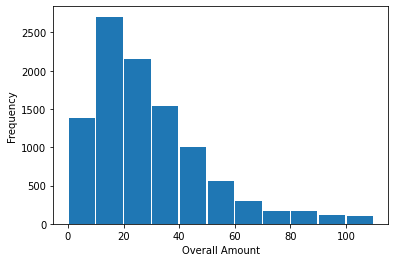

In [131]:
#visualise the overall transaction amount
df_purchase_overall = df['amount']
plt.hist(df_purchase_overall, bins=[0,10,20,30,40,50,60,70,80,90,100,110], rwidth= 0.95)
plt.xlabel('Overall Amount')
plt.ylabel('Frequency')

b. Monthly Transaction Volume

In [132]:
#visualise customers' average monthly transaction volume

customer = df.groupby('customer_id')
customer['amount'].count()

customer_id
CUS-1005756958     73
CUS-1117979751    100
CUS-1140341822     80
CUS-1147642491    118
CUS-1196156254    245
                 ... 
CUS-72755508       58
CUS-809013380     124
CUS-860700529     233
CUS-880898248      78
CUS-883482547     178
Name: amount, Length: 100, dtype: int64

In [ ]:
df_avg_transac_vol = df.groupby('customer_id')['amount'].count()


Text(0, 0.5, 'No of Customers')

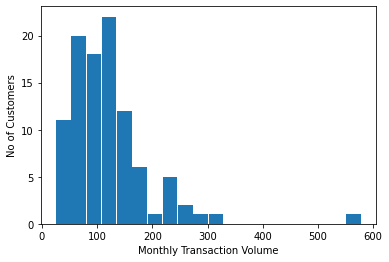

In [ ]:
plt.hist(df_avg_transac_vol, bins=20, rwidth=0.95)
plt.xlabel('Monthly Transaction Volume')
plt.ylabel('No of Customers')

c. Average Transaction Volume By Weekday

In [221]:
#segment the dataset by transaction date and time
#visualise transaction volume over an average week
day_order=["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]
to_date = df['date'].dt.day_name()
df['Weekday'] = to_date

In [222]:
#anz_transac_vol_weekday = 
ww = df.groupby('Weekday')['amount'].count().reset_index()
ww2= ww.set_index("Weekday").reindex(day_order).reset_index()
print(ww2)

     Weekday  amount
0     Monday    1360
1    Tuesday    1487
2  Wednesday    2063
3   Thursday    1801
4     Friday    2073
5   Saturday    1709
6     Sunday    1550


Text(0.5, 1.0, 'Weekday Transaction Volume')

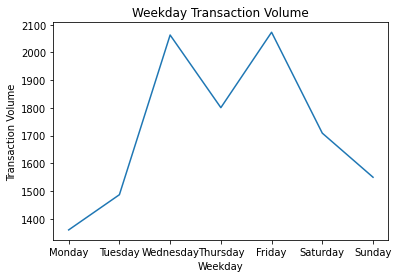

In [223]:
plt.plot(ww2['Weekday'], ww2['amount'])
plt.xlabel('Weekday')
plt.ylabel('Transaction Volume')
plt.title('Weekday Transaction Volume')

In [224]:
to_date = df['date'].dt.day_name()
df['Weekday'] = to_date

In [225]:
day_order=["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]

In [226]:
#First way of converting groupby series object to dataframe
df_date = df.groupby(['date', 'Weekday'])['amount'].count().reset_index()
print(df_date)
print(type(df_date))


         date    Weekday  amount
0  2018-08-01  Wednesday     137
1  2018-08-02   Thursday     152
2  2018-08-03     Friday     157
3  2018-08-04   Saturday     118
4  2018-08-05     Sunday     100
..        ...        ...     ...
86 2018-10-27   Saturday     139
87 2018-10-28     Sunday     143
88 2018-10-29     Monday     102
89 2018-10-30    Tuesday      89
90 2018-10-31  Wednesday     141

[91 rows x 3 columns]
<class 'pandas.core.frame.DataFrame'>


In [227]:
df_weekday = df_date.groupby(['Weekday'])['amount'].count().reset_index() 
print(type(df_weekday))
print(df_weekday)

<class 'pandas.core.frame.DataFrame'>
     Weekday  amount
0     Friday      13
1     Monday      13
2   Saturday      13
3     Sunday      13
4   Thursday      12
5    Tuesday      13
6  Wednesday      14


In [228]:
df_amount = df_date.groupby('Weekday')['amount'].sum().reset_index()              
print(df_amount)

     Weekday  amount
0     Friday    2073
1     Monday    1360
2   Saturday    1709
3     Sunday    1550
4   Thursday    1801
5    Tuesday    1487
6  Wednesday    2063


In [229]:
df_weekday['average_vol'] = df_amount['amount']/df_weekday['amount']
print(df_weekday)

     Weekday  amount  average_vol
0     Friday      13   159.461538
1     Monday      13   104.615385
2   Saturday      13   131.461538
3     Sunday      13   119.230769
4   Thursday      12   150.083333
5    Tuesday      13   114.384615
6  Wednesday      14   147.357143


In [230]:
df['avg_vol'] = df.groupby(['date', 'Weekday'])['amount'].transform('count')

In [231]:
print(df)

           status  card_present_flag         account currency       long_lat  \
0      authorized                1.0  ACC-1598451071      AUD  153.41 -27.95   
1      authorized                0.0  ACC-1598451071      AUD  153.41 -27.95   
2      authorized                1.0  ACC-1222300524      AUD  151.23 -33.94   
3      authorized                1.0  ACC-1037050564      AUD  153.10 -27.66   
4      authorized                1.0  ACC-1598451071      AUD  153.41 -27.95   
...           ...                ...             ...      ...            ...   
12038  authorized                0.0  ACC-3021093232      AUD  149.83 -29.47   
12039  authorized                1.0  ACC-1608363396      AUD  151.22 -33.87   
12040  authorized                1.0  ACC-3827517394      AUD  151.12 -33.89   
12041  authorized                1.0  ACC-2920611728      AUD  144.96 -37.76   
12042  authorized                1.0  ACC-1443681913      AUD  150.92 -33.77   

      txn_description                  

In [233]:
print(df[['date', 'Weekday', 'avg_vol']])


            date    Weekday  avg_vol
0     2018-08-01  Wednesday      137
1     2018-08-01  Wednesday      137
2     2018-08-01  Wednesday      137
3     2018-08-01  Wednesday      137
4     2018-08-01  Wednesday      137
...          ...        ...      ...
12038 2018-10-31  Wednesday      141
12039 2018-10-31  Wednesday      141
12040 2018-10-31  Wednesday      141
12041 2018-10-31  Wednesday      141
12042 2018-10-31  Wednesday      141

[12043 rows x 3 columns]


In [234]:
print(type(df))

<class 'pandas.core.frame.DataFrame'>


In [235]:
#perfect solution
df_test = df_date.groupby('Weekday')['amount'].count().reset_index(name='total_day')                 
print(df_test)

     Weekday  total_day
0     Friday         13
1     Monday         13
2   Saturday         13
3     Sunday         13
4   Thursday         12
5    Tuesday         13
6  Wednesday         14


In [236]:
df_test['total_transac'] = df_date.groupby('Weekday')['amount'].transform('sum')  #note here
print(df_test)

     Weekday  total_day  total_transac
0     Friday         13           2063
1     Monday         13           1801
2   Saturday         13           2073
3     Sunday         13           1709
4   Thursday         12           1550
5    Tuesday         13           1360
6  Wednesday         14           1487


In [237]:
#calculation can be performed with other dataframes also
df_test['avg_transac'] = df_date.groupby('Weekday')['amount'].transform('sum')/df_test['total_day']

In [238]:
df_test = df_test.set_index('Weekday').reindex(day_order).reset_index()
print(type(df_test))

<class 'pandas.core.frame.DataFrame'>


Text(0.5, 1.0, 'Average Weekday Transaction Volume')

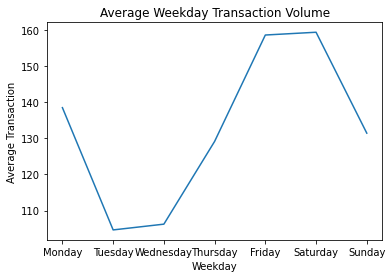

In [239]:
#Plot Graph in order
plt.plot(df_test['Weekday'], df_test['avg_transac'])
plt.xlabel('Weekday')
plt.ylabel('Average Transaction')
plt.title('Average Weekday Transaction Volume')

d. Average Transaction Volume By Hour

In [240]:
df.head()

,status,card_present_flag,account,currency,long_lat,txn_description,merchant_id,first_name,balance,date,...,consumer_longitude,consumer_latitude,merchant_longitude,merchant_latitude,Weekday,avg_vol,extraction_time,hour,distance(km),category
0,authorized,1.0,ACC-1598451071,AUD,153.41 -27.95,POS,81c48296-73be-44a7-befa-d053f48ce7cd,Diana,35.39,2018-08-01,...,153.41,-27.95,153.38,-27.99,Wednesday,137,2018-08-01 01:01:15,01,5.331721,Purchase
1,authorized,0.0,ACC-1598451071,AUD,153.41 -27.95,SALES-POS,830a451c-316e-4a6a-bf25-e37caedca49e,Diana,21.20,2018-08-01,...,153.41,-27.95,151.21,-33.87,Wednesday,137,2018-08-01 01:13:45,01,690.430719,Purchase
2,authorized,1.0,ACC-1222300524,AUD,151.23 -33.94,POS,835c231d-8cdf-4e96-859d-e9d571760cf0,Michael,5.71,2018-08-01,...,151.23,-33.94,151.21,-33.87,Wednesday,137,2018-08-01 01:26:15,01,7.994474,Purchase
3,authorized,1.0,ACC-1037050564,AUD,153.10 -27.66,SALES-POS,48514682-c78a-4a88-b0da-2d6302e64673,Rhonda,2117.22,2018-08-01,...,153.10,-27.66,153.05,-26.68,Wednesday,137,2018-08-01 01:38:45,01,109.014735,Purchase
4,authorized,1.0,ACC-1598451071,AUD,153.41 -27.95,SALES-POS,b4e02c10-0852-4273-b8fd-7b3395e32eb0,Diana,17.95,2018-08-01,...,153.41,-27.95,153.44,-28.06,Wednesday,137,2018-08-01 01:51:15,01,12.573143,Purchase


In [241]:
df.loc[df.txn_description == "PAY/SALARY", "category"] = "Salary"
df.loc[(df.txn_description == "SALES-POS") | (df.txn_description == "POS"), "category"] = "Purchase"
df.category.fillna("Others", inplace = True)
df[["txn_description", "category"]].head(10)

,txn_description,category
0,POS,Purchase
1,SALES-POS,Purchase
2,POS,Purchase
3,SALES-POS,Purchase
4,SALES-POS,Purchase
5,PAYMENT,Others
6,SALES-POS,Purchase
7,POS,Purchase
8,POS,Purchase
9,INTER BANK,Others


In [242]:
print(df['extraction'].dtypes)

object


In [243]:
print(type(df['extraction']))

<class 'pandas.core.series.Series'>


In [244]:
#convert object to datetime
df['extraction_time'] =df['extraction'].astype('datetime64[ns]')

df.head()
df['extraction'].dtypes
df.head()

,status,card_present_flag,account,currency,long_lat,txn_description,merchant_id,first_name,balance,date,...,consumer_longitude,consumer_latitude,merchant_longitude,merchant_latitude,Weekday,avg_vol,extraction_time,hour,distance(km),category
0,authorized,1.0,ACC-1598451071,AUD,153.41 -27.95,POS,81c48296-73be-44a7-befa-d053f48ce7cd,Diana,35.39,2018-08-01,...,153.41,-27.95,153.38,-27.99,Wednesday,137,2018-08-01 01:01:15,01,5.331721,Purchase
1,authorized,0.0,ACC-1598451071,AUD,153.41 -27.95,SALES-POS,830a451c-316e-4a6a-bf25-e37caedca49e,Diana,21.20,2018-08-01,...,153.41,-27.95,151.21,-33.87,Wednesday,137,2018-08-01 01:13:45,01,690.430719,Purchase
2,authorized,1.0,ACC-1222300524,AUD,151.23 -33.94,POS,835c231d-8cdf-4e96-859d-e9d571760cf0,Michael,5.71,2018-08-01,...,151.23,-33.94,151.21,-33.87,Wednesday,137,2018-08-01 01:26:15,01,7.994474,Purchase
3,authorized,1.0,ACC-1037050564,AUD,153.10 -27.66,SALES-POS,48514682-c78a-4a88-b0da-2d6302e64673,Rhonda,2117.22,2018-08-01,...,153.10,-27.66,153.05,-26.68,Wednesday,137,2018-08-01 01:38:45,01,109.014735,Purchase
4,authorized,1.0,ACC-1598451071,AUD,153.41 -27.95,SALES-POS,b4e02c10-0852-4273-b8fd-7b3395e32eb0,Diana,17.95,2018-08-01,...,153.41,-27.95,153.44,-28.06,Wednesday,137,2018-08-01 01:51:15,01,12.573143,Purchase


In [245]:
df['hour'] = df['extraction_time'].dt.strftime('%H')

In [246]:
df.head()

,status,card_present_flag,account,currency,long_lat,txn_description,merchant_id,first_name,balance,date,...,consumer_longitude,consumer_latitude,merchant_longitude,merchant_latitude,Weekday,avg_vol,extraction_time,hour,distance(km),category
0,authorized,1.0,ACC-1598451071,AUD,153.41 -27.95,POS,81c48296-73be-44a7-befa-d053f48ce7cd,Diana,35.39,2018-08-01,...,153.41,-27.95,153.38,-27.99,Wednesday,137,2018-08-01 01:01:15,01,5.331721,Purchase
1,authorized,0.0,ACC-1598451071,AUD,153.41 -27.95,SALES-POS,830a451c-316e-4a6a-bf25-e37caedca49e,Diana,21.20,2018-08-01,...,153.41,-27.95,151.21,-33.87,Wednesday,137,2018-08-01 01:13:45,01,690.430719,Purchase
2,authorized,1.0,ACC-1222300524,AUD,151.23 -33.94,POS,835c231d-8cdf-4e96-859d-e9d571760cf0,Michael,5.71,2018-08-01,...,151.23,-33.94,151.21,-33.87,Wednesday,137,2018-08-01 01:26:15,01,7.994474,Purchase
3,authorized,1.0,ACC-1037050564,AUD,153.10 -27.66,SALES-POS,48514682-c78a-4a88-b0da-2d6302e64673,Rhonda,2117.22,2018-08-01,...,153.10,-27.66,153.05,-26.68,Wednesday,137,2018-08-01 01:38:45,01,109.014735,Purchase
4,authorized,1.0,ACC-1598451071,AUD,153.41 -27.95,SALES-POS,b4e02c10-0852-4273-b8fd-7b3395e32eb0,Diana,17.95,2018-08-01,...,153.41,-27.95,153.44,-28.06,Wednesday,137,2018-08-01 01:51:15,01,12.573143,Purchase


In [247]:
df_hour_summary = df.groupby('hour')['Weekday'].count().reset_index(name='transac_vol')
df_hour_summary.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24 entries, 0 to 23
Data columns (total 2 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   hour         24 non-null     object
 1   transac_vol  24 non-null     int64 
dtypes: int64(1), object(1)
memory usage: 512.0+ bytes


In [248]:
df['hour'].unique()

array(['01', '02', '04', '06', '07', '08', '09', '10', '11', '12', '13',
       '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '00',
       '03', '05'], dtype=object)

In [249]:
df_hour_summary['avg_transaction'] = df_hour_summary['transac_vol'] / df_hour_summary['hour'].count()
df_hour_summary

,hour,transac_vol,avg_transaction
0,00,108,4.500000
1,01,214,8.916667
2,02,212,8.833333
3,03,196,8.166667
4,04,309,12.875000
5,05,209,8.708333
6,06,249,10.375000
7,07,266,11.083333
8,08,547,22.791667
9,09,1106,46.083333


Text(0.5, 1.0, 'Hourly Average Transaction Volume')

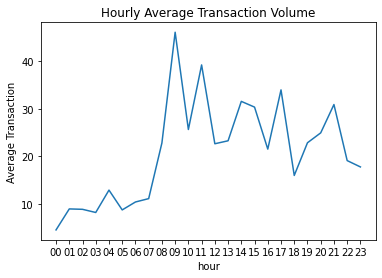

In [250]:
#Plot Graph in order
plt.plot(df_hour_summary['hour'], df_hour_summary['avg_transaction'])
plt.xlabel('hour')
plt.ylabel('Average Transaction')
plt.title('Hourly Average Transaction Volume')

In [251]:
#Exploring location information
#We could firstly see the distribution of distance betwwen a customer and the merchant he/she trades with
#Calculate distance based on longitude and latitude 
from numpy import cos, sin, arcsin, sqrt
from math import radians

def haversine(row):
    lon1 = row['consumer_longitude']
    lat1 = row['consumer_latitude']
    lon2 = row['merchant_longitude']
    lat2 = row['merchant_latitude']
    lon1, lat1, lon2, lat2 = map(radians, [lon1, lat1, lon2, lat2])
    dlon = lon2 - lon1 
    dlat = lat2 - lat1 
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * arcsin(sqrt(a)) 
    km = 6367 * c
    return km

df['distance(km)'] = df.apply(lambda row: haversine(row), axis=1)
df.head()

,status,card_present_flag,account,currency,long_lat,txn_description,merchant_id,first_name,balance,date,...,consumer_longitude,consumer_latitude,merchant_longitude,merchant_latitude,Weekday,avg_vol,extraction_time,hour,distance(km),category
0,authorized,1.0,ACC-1598451071,AUD,153.41 -27.95,POS,81c48296-73be-44a7-befa-d053f48ce7cd,Diana,35.39,2018-08-01,...,153.41,-27.95,153.38,-27.99,Wednesday,137,2018-08-01 01:01:15,01,5.331721,Purchase
1,authorized,0.0,ACC-1598451071,AUD,153.41 -27.95,SALES-POS,830a451c-316e-4a6a-bf25-e37caedca49e,Diana,21.20,2018-08-01,...,153.41,-27.95,151.21,-33.87,Wednesday,137,2018-08-01 01:13:45,01,690.430719,Purchase
2,authorized,1.0,ACC-1222300524,AUD,151.23 -33.94,POS,835c231d-8cdf-4e96-859d-e9d571760cf0,Michael,5.71,2018-08-01,...,151.23,-33.94,151.21,-33.87,Wednesday,137,2018-08-01 01:26:15,01,7.994474,Purchase
3,authorized,1.0,ACC-1037050564,AUD,153.10 -27.66,SALES-POS,48514682-c78a-4a88-b0da-2d6302e64673,Rhonda,2117.22,2018-08-01,...,153.10,-27.66,153.05,-26.68,Wednesday,137,2018-08-01 01:38:45,01,109.014735,Purchase
4,authorized,1.0,ACC-1598451071,AUD,153.41 -27.95,SALES-POS,b4e02c10-0852-4273-b8fd-7b3395e32eb0,Diana,17.95,2018-08-01,...,153.41,-27.95,153.44,-28.06,Wednesday,137,2018-08-01 01:51:15,01,12.573143,Purchase


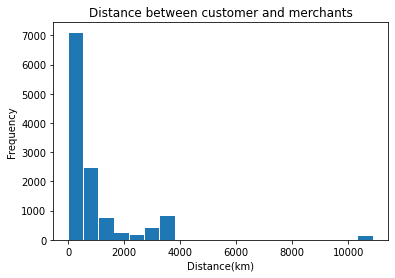

In [252]:
plt.hist(df['distance(km)'], rwidth= 0.95, bins=20)
plt.xlabel('Distance(km)')
plt.ylabel('Frequency')
plt.title('Distance between customer and merchants')
plt.show()

In [253]:
df['distance(km)'].max()

10890.446460164074

To validate, we could further plot the location of the customer and the merchants he/she trades with on a map

In [254]:
#create df with merchant latitude & longitude no NaNs

df_merchant = df[pd.notnull(df['merchant_latitude'])]
df_merchant.head(5)

,status,card_present_flag,account,currency,long_lat,txn_description,merchant_id,first_name,balance,date,...,consumer_longitude,consumer_latitude,merchant_longitude,merchant_latitude,Weekday,avg_vol,extraction_time,hour,distance(km),category
0,authorized,1.0,ACC-1598451071,AUD,153.41 -27.95,POS,81c48296-73be-44a7-befa-d053f48ce7cd,Diana,35.39,2018-08-01,...,153.41,-27.95,153.38,-27.99,Wednesday,137,2018-08-01 01:01:15,01,5.331721,Purchase
1,authorized,0.0,ACC-1598451071,AUD,153.41 -27.95,SALES-POS,830a451c-316e-4a6a-bf25-e37caedca49e,Diana,21.20,2018-08-01,...,153.41,-27.95,151.21,-33.87,Wednesday,137,2018-08-01 01:13:45,01,690.430719,Purchase
2,authorized,1.0,ACC-1222300524,AUD,151.23 -33.94,POS,835c231d-8cdf-4e96-859d-e9d571760cf0,Michael,5.71,2018-08-01,...,151.23,-33.94,151.21,-33.87,Wednesday,137,2018-08-01 01:26:15,01,7.994474,Purchase
3,authorized,1.0,ACC-1037050564,AUD,153.10 -27.66,SALES-POS,48514682-c78a-4a88-b0da-2d6302e64673,Rhonda,2117.22,2018-08-01,...,153.10,-27.66,153.05,-26.68,Wednesday,137,2018-08-01 01:38:45,01,109.014735,Purchase
4,authorized,1.0,ACC-1598451071,AUD,153.41 -27.95,SALES-POS,b4e02c10-0852-4273-b8fd-7b3395e32eb0,Diana,17.95,2018-08-01,...,153.41,-27.95,153.44,-28.06,Wednesday,137,2018-08-01 01:51:15,01,12.573143,Purchase


In [ ]:
!pip install folium
import folium

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
aus_map = folium.Map(location=[-37.8136, 144.96], zoom_start=5)

#display map
aus_map

In [ ]:
#instantiate a feature group for the incidents in the dataframe
merchants= folium.map.FeatureGroup()



#loop through the merchants and add each to the merchants feature group
for lat, lng in zip(df_merchant.merchant_latitude, df_merchant.merchant_longitude):
    merchants.add_child(
        folium.features.CircleMarker(
            [lat, lng],
            radius=5,
            color='red',
            fill= True,
            fill_color='blue',
            fill_opacity=0.6
        )
    )
    #add pop out text to eacg marker on the map
latitudes = list(df_merchant['merchant_latitude'])
longitudes = list(df_merchant['merchant_longitude'])
labels = list(df_merchant['txn_description'])    

for lat, lng, label in zip(latitudes, longitudes, labels):
    folium.Marker([lat, lng], popup=label).add_to(aus_map)
    

#add merchants to map
aus_map.add_child(merchants)

Gather some interesting overall insights about the data

5.2.1 Identify the annual salary for each customer

# 4. Pridictive Analysis-Vitual Internship Task 2

#find out pay/salary row

In [171]:
df_cust_id = pd.DataFrame(df['customer_id'].unique(), columns=['customer_id'])

In [175]:
print(type(df_cust_id))
print(len(df_cust_id))
print(df_cust_id)

<class 'pandas.core.frame.DataFrame'>
100
       customer_id
0   CUS-2487424745
1   CUS-2142601169
2   CUS-1614226872
3   CUS-2688605418
4   CUS-4123612273
..             ...
95  CUS-2505971401
96  CUS-2819545904
97  CUS-3395687666
98  CUS-1147642491
99   CUS-261674136

[100 rows x 1 columns]


In [172]:
df['txn_description'].unique()

array(['POS', 'SALES-POS', 'PAYMENT', 'INTER BANK', 'PAY/SALARY',
       'PHONE BANK'], dtype=object)

In [173]:
df_w_pay = df[df['txn_description'] == 'PAY/SALARY']

In [174]:
print(type(df_w_pay))

<class 'pandas.core.frame.DataFrame'>


In [170]:

#create two dataframes and join together
df_cust_salary = df_w_pay.groupby('customer_id')['amount'].count().reset_index(name='frequency')
df_cust_salary_total = df_w_pay.groupby('customer_id')['amount'].sum().reset_index(name='total_salary')

df_cust_salary = pd.merge(df_cust_salary, df_cust_salary_total[['customer_id', 'total_salary']], on='customer_id', how='left')
display(df_cust_salary)

,customer_id,frequency,total_salary
0,CUS-1005756958,13,12616.11
1,CUS-1117979751,7,25050.55
2,CUS-1140341822,6,11499.06
3,CUS-1147642491,13,22248.07
4,CUS-1196156254,7,27326.11
...,...,...,...
95,CUS-72755508,12,8703.84
96,CUS-809013380,13,13481.91
97,CUS-860700529,6,10851.72
98,CUS-880898248,6,8603.88


In [176]:
df_cust_salary['Annual_Sal'] = 0
for i in range(0, len(df_cust_salary['frequency'])):
    if df_cust_salary['frequency'][i] >=12:
        df_cust_salary['Annual_Sal'][i] = df_cust_salary['total_salary'][i] /7*365.25/1000
    elif df_cust_salary['frequency'][i] <=5:
        df_cust_salary['Annual_Sal'][i] = df_cust_salary['total_salary'][i] *12/1000
    else:
        df_cust_salary['Annual_Sal'][i] = df_cust_salary['total_salary'][i] /14*365.25/1000

display(df_cust_salary)  

,customer_id,frequency,total_salary,Annual_Sal
0,CUS-1005756958,13,12616.11,658
1,CUS-1117979751,7,25050.55,653
2,CUS-1140341822,6,11499.06,300
3,CUS-1147642491,13,22248.07,1160
4,CUS-1196156254,7,27326.11,712
...,...,...,...,...
95,CUS-72755508,12,8703.84,454
96,CUS-809013380,13,13481.91,703
97,CUS-860700529,6,10851.72,283
98,CUS-880898248,6,8603.88,224


In [178]:
print(type(df_cust_id))
print(len(df_cust_id))
print(df_cust_id)

<class 'pandas.core.frame.DataFrame'>
100
       customer_id
0   CUS-2487424745
1   CUS-2142601169
2   CUS-1614226872
3   CUS-2688605418
4   CUS-4123612273
..             ...
95  CUS-2505971401
96  CUS-2819545904
97  CUS-3395687666
98  CUS-1147642491
99   CUS-261674136

[100 rows x 1 columns]


In [179]:
df.head()

,status,card_present_flag,account,currency,long_lat,txn_description,merchant_id,first_name,balance,date,...,consumer_longitude,consumer_latitude,merchant_longitude,merchant_latitude,Weekday,avg_vol,extraction_time,hour,distance(km),category
0,authorized,1.0,ACC-1598451071,AUD,153.41 -27.95,POS,81c48296-73be-44a7-befa-d053f48ce7cd,Diana,35.39,2018-08-01,...,153.41,-27.95,153.38,-27.99,Wednesday,137,2018-08-01 01:01:15,01,5.331721,Purchase
1,authorized,0.0,ACC-1598451071,AUD,153.41 -27.95,SALES-POS,830a451c-316e-4a6a-bf25-e37caedca49e,Diana,21.20,2018-08-01,...,153.41,-27.95,151.21,-33.87,Wednesday,137,2018-08-01 01:13:45,01,690.430719,Purchase
2,authorized,1.0,ACC-1222300524,AUD,151.23 -33.94,POS,835c231d-8cdf-4e96-859d-e9d571760cf0,Michael,5.71,2018-08-01,...,151.23,-33.94,151.21,-33.87,Wednesday,137,2018-08-01 01:26:15,01,7.994474,Purchase
3,authorized,1.0,ACC-1037050564,AUD,153.10 -27.66,SALES-POS,48514682-c78a-4a88-b0da-2d6302e64673,Rhonda,2117.22,2018-08-01,...,153.10,-27.66,153.05,-26.68,Wednesday,137,2018-08-01 01:38:45,01,109.014735,Purchase
4,authorized,1.0,ACC-1598451071,AUD,153.41 -27.95,SALES-POS,b4e02c10-0852-4273-b8fd-7b3395e32eb0,Diana,17.95,2018-08-01,...,153.41,-27.95,153.44,-28.06,Wednesday,137,2018-08-01 01:51:15,01,12.573143,Purchase


In [180]:
df_cust_salary['Annual_Sal'] = 0
for i in range(0, len(df_cust_salary['frequency'])):
    if df_cust_salary['frequency'][i] >=12:
        df_cust_salary['Annual_Sal'][i] = df_cust_salary['total_salary'][i] /7*365.25/1000
    elif df_cust_salary['frequency'][i] <=5:
        df_cust_salary['Annual_Sal'][i] = df_cust_salary['total_salary'][i] *12/1000
    else:
        df_cust_salary['Annual_Sal'][i] = df_cust_salary['total_salary'][i] /14*365.25/1000

display(df_cust_salary) 

,customer_id,frequency,total_salary,Annual_Sal
0,CUS-1005756958,13,12616.11,658
1,CUS-1117979751,7,25050.55,653
2,CUS-1140341822,6,11499.06,300
3,CUS-1147642491,13,22248.07,1160
4,CUS-1196156254,7,27326.11,712
...,...,...,...,...
95,CUS-72755508,12,8703.84,454
96,CUS-809013380,13,13481.91,703
97,CUS-860700529,6,10851.72,283
98,CUS-880898248,6,8603.88,224


Text(0.5, 1.0, "Customers' Annual Salary(k)")

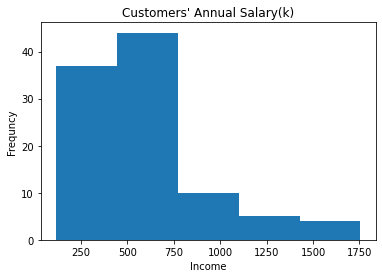

In [177]:
plt.hist(df_cust_salary['Annual_Sal'], bins=5)
plt.xlabel('Income')
plt.ylabel('Frequncy')
plt.title("Customers' Annual Salary(k)")

Explore correlations between annual salary and various customer attributes


In [124]:
"""test on groupby vs groupby transform"""
df_w_pay
df_new_test = df_w_pay.groupby('gender')['amount'].sum().reset_index(name='amount')
df_balance_wo_transform = df_w_pay.groupby('gender')['balance'].sum().reset_index(name='xx')                      
df_balance_transform = df_w_pay.groupby('gender')['balance'].transform('sum')             
df_new_test['balance'] = 0
df_new_test['balance'] = df_balance_wo_transform['xx']
df_new_test2 = df_w_pay.groupby('gender')['balance'].sum().reset_index(name='balance')

df_test_balance = df_w_pay.groupby('gender')['balance'].sum().reset_index(name='balance')
"""either way will do (.values), .to_numpy()"""
df_test_balance['amount'] = df_w_pay.groupby('gender')['balance'].sum().values
"""test on groupby vs groupby transform"""
df_w_pay
# display(anz_w_pay)
anz_new_test = df_w_pay.groupby('gender')['amount'].sum().reset_index(name='amount')
df_balance_wo_transform = df_w_pay.groupby('gender')['balance'].sum().reset_index(name='xx')                      
df_balance_transform = df_w_pay.groupby('gender')['balance'].transform('sum')             

df_new_test['balance'] = 0
df_new_test['balance'] = df_balance_wo_transform['xx']

df_new_test2 = df_w_pay.groupby('gender')['balance'].sum().reset_index(name='balance')
print(type(df_test_balance['amount']))
display(df_test_balance)

<class 'pandas.core.series.Series'>


,gender,balance,amount
0,F,4913956.70,4913956.70
1,M,9428487.84,9428487.84


In [181]:
#create a dataframe to store relevant features for customers
df_cust_behaviour = df[['customer_id', 'gender', 'amount', 'date', 'balance']]
display(df_cust_behaviour)
print(type(df_cust_behaviour))

,customer_id,gender,amount,date,balance
0,CUS-2487424745,F,16.25,2018-08-01,35.39
1,CUS-2487424745,F,14.19,2018-08-01,21.20
2,CUS-2142601169,M,6.42,2018-08-01,5.71
3,CUS-1614226872,F,40.90,2018-08-01,2117.22
4,CUS-2487424745,F,3.25,2018-08-01,17.95
...,...,...,...,...,...
12038,CUS-55310383,F,9.79,2018-10-31,14054.14
12039,CUS-2688605418,M,63.87,2018-10-31,9137.79
12040,CUS-2663907001,M,43.96,2018-10-31,45394.57
12041,CUS-1388323263,M,30.77,2018-10-31,11350.67


<class 'pandas.core.frame.DataFrame'>


In [65]:
df_cust_behaviour_summary = df_cust_behaviour.groupby('customer_id')['amount'].sum().reset_index(name='total_amount')

#display(anz_cust_behaviour_summary)

#create new column
df_cust_behaviour_summary['weekly_average_transaction'] = 0
df_cust_behaviour_summary['max_amount'] = 0
df_cust_behaviour_summary['no_large_transaction'] = 0
df_cust_behaviour_summary['use_no_day'] = 0
df_cust_behaviour_summary['avg_transac_amount'] = 0 
df_cust_behaviour_summary['median_balance'] = 0

In [182]:
#max_amount
df_max = df_cust_behaviour.groupby('customer_id')['amount'].max().reset_index(name='max_max')
df_max

,customer_id,max_max
0,CUS-1005756958,970.47
1,CUS-1117979751,3578.65
2,CUS-1140341822,1916.51
3,CUS-1147642491,1711.39
4,CUS-1196156254,3903.73
...,...,...
95,CUS-72755508,1180.00
96,CUS-809013380,1383.00
97,CUS-860700529,1808.62
98,CUS-880898248,1433.98


In [183]:
df_cust_behaviour_summary['max_amount'] = df_max['max_max']
df_testtest = df_cust_behaviour.groupby('customer_id')['amount'].max().reset_index(name='max')

In [184]:

#avg_transac_amount
avg_amount = df_cust_behaviour.groupby('customer_id')['amount'].mean().reset_index(name='avg_amount')
df_cust_behaviour_summary['avg_transac_amount'] = avg_amount['avg_amount']

In [186]:
#median balance
df_median = df_cust_behaviour.groupby('customer_id')['balance'].median().reset_index(name='median_balance')
df_cust_behaviour_summary['median_balance'] = df_median['median_balance']

In [187]:
#no_of_day transaction made
df_date = df_cust_behaviour.groupby('customer_id')['date'].nunique().reset_index(name='unique_date')
display(df_date)

,customer_id,unique_date
0,CUS-1005756958,40
1,CUS-1117979751,60
2,CUS-1140341822,42
3,CUS-1147642491,54
4,CUS-1196156254,79
...,...,...
95,CUS-72755508,42
96,CUS-809013380,50
97,CUS-860700529,67
98,CUS-880898248,43


In [189]:
print(f'df is {type(df_date)}')
df_cust_behaviour_summary['use_no_day'] = df_date['unique_date']

df is <class 'pandas.core.frame.DataFrame'>


In [190]:
df_weekly_transaction = df_cust_behaviour.groupby('customer_id')['amount'].count().reset_index(name='total_transaction_count')
df_weekly_transaction['count_date'] = df_date['unique_date']
df_weekly_transaction['avg_transac'] = round(df_weekly_transaction['total_transaction_count']/df_date['unique_date']*7 )
display(df_weekly_transaction)
df_cust_behaviour_summary['weekly_average_transaction'] = round(df_weekly_transaction['total_transaction_count']/df_date['unique_date']*7)

,customer_id,total_transaction_count,count_date,avg_transac
0,CUS-1005756958,73,40,13.0
1,CUS-1117979751,100,60,12.0
2,CUS-1140341822,80,42,13.0
3,CUS-1147642491,118,54,15.0
4,CUS-1196156254,245,79,22.0
...,...,...,...,...
95,CUS-72755508,58,42,10.0
96,CUS-809013380,124,50,17.0
97,CUS-860700529,233,67,24.0
98,CUS-880898248,78,43,13.0


In [191]:
df_cust_behaviour_summary['no_large_transaction'] = df_cust_behaviour[df_cust_behaviour['amount']>=100].groupby('customer_id')['amount'].count().values

display(df_cust_behaviour_summary)

,customer_id,total_amount,weekly_average_transaction,max_amount,no_large_transaction,use_no_day,avg_transac_amount,median_balance,gender,age,state,annual_salary,age_below20,age_btw20n40,age_btw40n60
0,CUS-1005756958,16268.97,13.0,970.47,29,40,222.862603,1204.400,F,53,QLD,6.582906e+05,0,0,1
1,CUS-1117979751,33984.37,12.0,3578.65,16,60,339.843700,8838.410,M,21,NSW,6.535510e+05,0,1,0
2,CUS-1140341822,17010.60,13.0,1916.51,14,42,212.632500,6358.350,M,28,VIC,3.000023e+05,0,1,0
3,CUS-1147642491,28980.82,15.0,1711.39,31,54,245.600169,8473.430,F,34,NSW,1.160873e+06,0,1,0
4,CUS-1196156254,36050.72,22.0,3903.73,21,79,147.145796,22312.760,F,34,NSW,7.129187e+05,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,CUS-72755508,11438.37,10.0,1180.00,16,42,197.213276,5211.095,F,35,NSW,4.541539e+05,0,1,0
96,CUS-809013380,18810.09,17.0,1383.00,21,50,151.694274,3123.775,F,21,NSW,7.034668e+05,0,1,0
97,CUS-860700529,18099.88,24.0,1808.62,19,67,77.681888,3885.510,M,30,NSW,2.831136e+05,0,1,0
98,CUS-880898248,11462.45,13.0,1433.98,10,43,146.954487,8486.475,M,26,NSW,2.244691e+05,0,1,0


In [192]:
df_cust_behaviour_summary.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 15 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   customer_id                 100 non-null    object 
 1   total_amount                100 non-null    float64
 2   weekly_average_transaction  100 non-null    float64
 3   max_amount                  100 non-null    float64
 4   no_large_transaction        100 non-null    int64  
 5   use_no_day                  100 non-null    int64  
 6   avg_transac_amount          100 non-null    float64
 7   median_balance              100 non-null    float64
 8   gender                      100 non-null    object 
 9   age                         100 non-null    int64  
 10  state                       98 non-null     object 
 11  annual_salary               100 non-null    float64
 12  age_below20                 100 non-null    int64  
 13  age_btw20n40                100 non-

In [193]:
df_cust_behaviour_summary.head()

,customer_id,total_amount,weekly_average_transaction,max_amount,no_large_transaction,use_no_day,avg_transac_amount,median_balance,gender,age,state,annual_salary,age_below20,age_btw20n40,age_btw40n60
0,CUS-1005756958,16268.97,13.0,970.47,29,40,222.862603,1204.40,F,53,QLD,6.582906e+05,0,0,1
1,CUS-1117979751,33984.37,12.0,3578.65,16,60,339.843700,8838.41,M,21,NSW,6.535510e+05,0,1,0
2,CUS-1140341822,17010.60,13.0,1916.51,14,42,212.632500,6358.35,M,28,VIC,3.000023e+05,0,1,0
3,CUS-1147642491,28980.82,15.0,1711.39,31,54,245.600169,8473.43,F,34,NSW,1.160873e+06,0,1,0
4,CUS-1196156254,36050.72,22.0,3903.73,21,79,147.145796,22312.76,F,34,NSW,7.129187e+05,0,1,0


In [194]:
df_cust_behaviour_summary['annual _salary'] = 0
df_cust_behaviour_summary['gender'] = 0
df_cust_behaviour_summary['age'] = 0
df_cust_behaviour_summary['state'] = 0


df_cust_behaviour_summary.head()

,customer_id,total_amount,weekly_average_transaction,max_amount,no_large_transaction,use_no_day,avg_transac_amount,median_balance,gender,age,state,annual_salary,age_below20,age_btw20n40,age_btw40n60,annual _salary
0,CUS-1005756958,16268.97,13.0,970.47,29,40,222.862603,1204.40,0,0,0,6.582906e+05,0,0,1,0
1,CUS-1117979751,33984.37,12.0,3578.65,16,60,339.843700,8838.41,0,0,0,6.535510e+05,0,1,0,0
2,CUS-1140341822,17010.60,13.0,1916.51,14,42,212.632500,6358.35,0,0,0,3.000023e+05,0,1,0,0
3,CUS-1147642491,28980.82,15.0,1711.39,31,54,245.600169,8473.43,0,0,0,1.160873e+06,0,1,0,0
4,CUS-1196156254,36050.72,22.0,3903.73,21,79,147.145796,22312.76,0,0,0,7.129187e+05,0,1,0,0


In [195]:
df_cust_behaviour_summary['annual_salary'] = df_cust_salary['Annual_Sal']

In [196]:
df_cust_behaviour_summary.head()

,customer_id,total_amount,weekly_average_transaction,max_amount,no_large_transaction,use_no_day,avg_transac_amount,median_balance,gender,age,state,annual_salary,age_below20,age_btw20n40,age_btw40n60,annual _salary
0,CUS-1005756958,16268.97,13.0,970.47,29,40,222.862603,1204.40,0,0,0,658,0,0,1,0
1,CUS-1117979751,33984.37,12.0,3578.65,16,60,339.843700,8838.41,0,0,0,653,0,1,0,0
2,CUS-1140341822,17010.60,13.0,1916.51,14,42,212.632500,6358.35,0,0,0,300,0,1,0,0
3,CUS-1147642491,28980.82,15.0,1711.39,31,54,245.600169,8473.43,0,0,0,1160,0,1,0,0
4,CUS-1196156254,36050.72,22.0,3903.73,21,79,147.145796,22312.76,0,0,0,712,0,1,0,0


In [197]:
df.head()

,status,card_present_flag,account,currency,long_lat,txn_description,merchant_id,first_name,balance,date,...,consumer_longitude,consumer_latitude,merchant_longitude,merchant_latitude,Weekday,avg_vol,extraction_time,hour,distance(km),category
0,authorized,1.0,ACC-1598451071,AUD,153.41 -27.95,POS,81c48296-73be-44a7-befa-d053f48ce7cd,Diana,35.39,2018-08-01,...,153.41,-27.95,153.38,-27.99,Wednesday,137,2018-08-01 01:01:15,01,5.331721,Purchase
1,authorized,0.0,ACC-1598451071,AUD,153.41 -27.95,SALES-POS,830a451c-316e-4a6a-bf25-e37caedca49e,Diana,21.20,2018-08-01,...,153.41,-27.95,151.21,-33.87,Wednesday,137,2018-08-01 01:13:45,01,690.430719,Purchase
2,authorized,1.0,ACC-1222300524,AUD,151.23 -33.94,POS,835c231d-8cdf-4e96-859d-e9d571760cf0,Michael,5.71,2018-08-01,...,151.23,-33.94,151.21,-33.87,Wednesday,137,2018-08-01 01:26:15,01,7.994474,Purchase
3,authorized,1.0,ACC-1037050564,AUD,153.10 -27.66,SALES-POS,48514682-c78a-4a88-b0da-2d6302e64673,Rhonda,2117.22,2018-08-01,...,153.10,-27.66,153.05,-26.68,Wednesday,137,2018-08-01 01:38:45,01,109.014735,Purchase
4,authorized,1.0,ACC-1598451071,AUD,153.41 -27.95,SALES-POS,b4e02c10-0852-4273-b8fd-7b3395e32eb0,Diana,17.95,2018-08-01,...,153.41,-27.95,153.44,-28.06,Wednesday,137,2018-08-01 01:51:15,01,12.573143,Purchase


In [198]:
df_cust_behaviour_summary['age'] = df.groupby('customer_id')['age'].max().values

In [199]:
df_cust_behaviour_summary.head()

,customer_id,total_amount,weekly_average_transaction,max_amount,no_large_transaction,use_no_day,avg_transac_amount,median_balance,gender,age,state,annual_salary,age_below20,age_btw20n40,age_btw40n60,annual _salary
0,CUS-1005756958,16268.97,13.0,970.47,29,40,222.862603,1204.40,0,53,0,658,0,0,1,0
1,CUS-1117979751,33984.37,12.0,3578.65,16,60,339.843700,8838.41,0,21,0,653,0,1,0,0
2,CUS-1140341822,17010.60,13.0,1916.51,14,42,212.632500,6358.35,0,28,0,300,0,1,0,0
3,CUS-1147642491,28980.82,15.0,1711.39,31,54,245.600169,8473.43,0,34,0,1160,0,1,0,0
4,CUS-1196156254,36050.72,22.0,3903.73,21,79,147.145796,22312.76,0,34,0,712,0,1,0,0


In [200]:
df_cust_behaviour_summary['gender'] = df.groupby('customer_id')['gender'].max().values

In [201]:
df_cust_behaviour_summary.head()

,customer_id,total_amount,weekly_average_transaction,max_amount,no_large_transaction,use_no_day,avg_transac_amount,median_balance,gender,age,state,annual_salary,age_below20,age_btw20n40,age_btw40n60,annual _salary
0,CUS-1005756958,16268.97,13.0,970.47,29,40,222.862603,1204.40,F,53,0,658,0,0,1,0
1,CUS-1117979751,33984.37,12.0,3578.65,16,60,339.843700,8838.41,M,21,0,653,0,1,0,0
2,CUS-1140341822,17010.60,13.0,1916.51,14,42,212.632500,6358.35,M,28,0,300,0,1,0,0
3,CUS-1147642491,28980.82,15.0,1711.39,31,54,245.600169,8473.43,F,34,0,1160,0,1,0,0
4,CUS-1196156254,36050.72,22.0,3903.73,21,79,147.145796,22312.76,F,34,0,712,0,1,0,0


In [202]:
df.head()

,status,card_present_flag,account,currency,long_lat,txn_description,merchant_id,first_name,balance,date,...,consumer_longitude,consumer_latitude,merchant_longitude,merchant_latitude,Weekday,avg_vol,extraction_time,hour,distance(km),category
0,authorized,1.0,ACC-1598451071,AUD,153.41 -27.95,POS,81c48296-73be-44a7-befa-d053f48ce7cd,Diana,35.39,2018-08-01,...,153.41,-27.95,153.38,-27.99,Wednesday,137,2018-08-01 01:01:15,01,5.331721,Purchase
1,authorized,0.0,ACC-1598451071,AUD,153.41 -27.95,SALES-POS,830a451c-316e-4a6a-bf25-e37caedca49e,Diana,21.20,2018-08-01,...,153.41,-27.95,151.21,-33.87,Wednesday,137,2018-08-01 01:13:45,01,690.430719,Purchase
2,authorized,1.0,ACC-1222300524,AUD,151.23 -33.94,POS,835c231d-8cdf-4e96-859d-e9d571760cf0,Michael,5.71,2018-08-01,...,151.23,-33.94,151.21,-33.87,Wednesday,137,2018-08-01 01:26:15,01,7.994474,Purchase
3,authorized,1.0,ACC-1037050564,AUD,153.10 -27.66,SALES-POS,48514682-c78a-4a88-b0da-2d6302e64673,Rhonda,2117.22,2018-08-01,...,153.10,-27.66,153.05,-26.68,Wednesday,137,2018-08-01 01:38:45,01,109.014735,Purchase
4,authorized,1.0,ACC-1598451071,AUD,153.41 -27.95,SALES-POS,b4e02c10-0852-4273-b8fd-7b3395e32eb0,Diana,17.95,2018-08-01,...,153.41,-27.95,153.44,-28.06,Wednesday,137,2018-08-01 01:51:15,01,12.573143,Purchase


In [203]:
df_salary2 = df[df['txn_description'] == 'PAY/SALARY'].groupby('customer_id')['txn_description'].count().reset_index(name= 'pay_frequency')

In [204]:
df_salary2['total_payment_received'] = 0
df_salary2['annual_salary'] = 0
df_salary2.head()

,customer_id,pay_frequency,total_payment_received,annual_salary
0,CUS-1005756958,13,0,0
1,CUS-1117979751,7,0,0
2,CUS-1140341822,6,0,0
3,CUS-1147642491,13,0,0
4,CUS-1196156254,7,0,0


In [206]:
column_name = list(df_salary2.columns.values)
column_name


['customer_id', 'total_payment_received', 'pay_frequency', 'annual_salary']

In [207]:
df_salary2 = df_salary2[['customer_id', 'total_payment_received', 'pay_frequency', 'annual_salary']]
df_salary2.head()

,customer_id,total_payment_received,pay_frequency,annual_salary
0,CUS-1005756958,0,13,0
1,CUS-1117979751,0,7,0
2,CUS-1140341822,0,6,0
3,CUS-1147642491,0,13,0
4,CUS-1196156254,0,7,0


In [208]:
df_salary2['total_payment_received']= df[df['txn_description'] == 'PAY/SALARY'].groupby('customer_id')['amount'].sum().values
df_salary2.head()

,customer_id,total_payment_received,pay_frequency,annual_salary
0,CUS-1005756958,12616.11,13,0
1,CUS-1117979751,25050.55,7,0
2,CUS-1140341822,11499.06,6,0
3,CUS-1147642491,22248.07,13,0
4,CUS-1196156254,27326.11,7,0


In [209]:
df_salary2.head()

,customer_id,total_payment_received,pay_frequency,annual_salary
0,CUS-1005756958,12616.11,13,0
1,CUS-1117979751,25050.55,7,0
2,CUS-1140341822,11499.06,6,0
3,CUS-1147642491,22248.07,13,0
4,CUS-1196156254,27326.11,7,0


In [210]:
df_cust_behaviour_summary['annual_salary']= df_salary2['annual_salary']
df_cust_behaviour_summary.drop(df_cust_behaviour_summary.columns[8], axis= 1, inplace= True)
df_cust_behaviour_summary.head()

,customer_id,total_amount,weekly_average_transaction,max_amount,no_large_transaction,use_no_day,avg_transac_amount,median_balance,age,state,annual_salary,age_below20,age_btw20n40,age_btw40n60,annual _salary
0,CUS-1005756958,16268.97,13.0,970.47,29,40,222.862603,1204.40,53,0,0,0,0,1,0
1,CUS-1117979751,33984.37,12.0,3578.65,16,60,339.843700,8838.41,21,0,0,0,1,0,0
2,CUS-1140341822,17010.60,13.0,1916.51,14,42,212.632500,6358.35,28,0,0,0,1,0,0
3,CUS-1147642491,28980.82,15.0,1711.39,31,54,245.600169,8473.43,34,0,0,0,1,0,0
4,CUS-1196156254,36050.72,22.0,3903.73,21,79,147.145796,22312.76,34,0,0,0,1,0,0


In [211]:
df_cust_behaviour_summary['age_below20'] = 0
df_cust_behaviour_summary['age_btw20n40'] = 0
df_cust_behaviour_summary['age_btw40n60'] = 0
df_cust_behaviour_summary.head()

,customer_id,total_amount,weekly_average_transaction,max_amount,no_large_transaction,use_no_day,avg_transac_amount,median_balance,age,state,annual_salary,age_below20,age_btw20n40,age_btw40n60,annual _salary
0,CUS-1005756958,16268.97,13.0,970.47,29,40,222.862603,1204.40,53,0,0,0,0,0,0
1,CUS-1117979751,33984.37,12.0,3578.65,16,60,339.843700,8838.41,21,0,0,0,0,0,0
2,CUS-1140341822,17010.60,13.0,1916.51,14,42,212.632500,6358.35,28,0,0,0,0,0,0
3,CUS-1147642491,28980.82,15.0,1711.39,31,54,245.600169,8473.43,34,0,0,0,0,0,0
4,CUS-1196156254,36050.72,22.0,3903.73,21,79,147.145796,22312.76,34,0,0,0,0,0,0


In [212]:
def age_20(age):
    if age <= 20:
        return 1
    return 0

def age_40(age):
    if 20 <age <= 40:
        return 1
    return 0

def age_60(age):
    if 40 <age <= 60:
        return 1
    return 0

df_cust_behaviour_summary['age_below20'] = np.vectorize(age_20)(df_cust_behaviour_summary['age'])
df_cust_behaviour_summary['age_btw20n40'] = np.vectorize(age_40)(df_cust_behaviour_summary['age'])
df_cust_behaviour_summary['age_btw40n60'] = np.vectorize(age_60)(df_cust_behaviour_summary['age'])

df_cust_behaviour_summary.head()

,customer_id,total_amount,weekly_average_transaction,max_amount,no_large_transaction,use_no_day,avg_transac_amount,median_balance,age,state,annual_salary,age_below20,age_btw20n40,age_btw40n60,annual _salary
0,CUS-1005756958,16268.97,13.0,970.47,29,40,222.862603,1204.40,53,0,0,0,0,1,0
1,CUS-1117979751,33984.37,12.0,3578.65,16,60,339.843700,8838.41,21,0,0,0,1,0,0
2,CUS-1140341822,17010.60,13.0,1916.51,14,42,212.632500,6358.35,28,0,0,0,1,0,0
3,CUS-1147642491,28980.82,15.0,1711.39,31,54,245.600169,8473.43,34,0,0,0,1,0,0
4,CUS-1196156254,36050.72,22.0,3903.73,21,79,147.145796,22312.76,34,0,0,0,1,0,0


In [213]:
df.head()

,status,card_present_flag,account,currency,long_lat,txn_description,merchant_id,first_name,balance,date,...,consumer_longitude,consumer_latitude,merchant_longitude,merchant_latitude,Weekday,avg_vol,extraction_time,hour,distance(km),category
0,authorized,1.0,ACC-1598451071,AUD,153.41 -27.95,POS,81c48296-73be-44a7-befa-d053f48ce7cd,Diana,35.39,2018-08-01,...,153.41,-27.95,153.38,-27.99,Wednesday,137,2018-08-01 01:01:15,01,5.331721,Purchase
1,authorized,0.0,ACC-1598451071,AUD,153.41 -27.95,SALES-POS,830a451c-316e-4a6a-bf25-e37caedca49e,Diana,21.20,2018-08-01,...,153.41,-27.95,151.21,-33.87,Wednesday,137,2018-08-01 01:13:45,01,690.430719,Purchase
2,authorized,1.0,ACC-1222300524,AUD,151.23 -33.94,POS,835c231d-8cdf-4e96-859d-e9d571760cf0,Michael,5.71,2018-08-01,...,151.23,-33.94,151.21,-33.87,Wednesday,137,2018-08-01 01:26:15,01,7.994474,Purchase
3,authorized,1.0,ACC-1037050564,AUD,153.10 -27.66,SALES-POS,48514682-c78a-4a88-b0da-2d6302e64673,Rhonda,2117.22,2018-08-01,...,153.10,-27.66,153.05,-26.68,Wednesday,137,2018-08-01 01:38:45,01,109.014735,Purchase
4,authorized,1.0,ACC-1598451071,AUD,153.41 -27.95,SALES-POS,b4e02c10-0852-4273-b8fd-7b3395e32eb0,Diana,17.95,2018-08-01,...,153.41,-27.95,153.44,-28.06,Wednesday,137,2018-08-01 01:51:15,01,12.573143,Purchase


In [214]:
#investigate the state where customers live
#assume they live where most transactions occured (indicated by merchant_state)
merchant_state = df.groupby(['customer_id', 'merchant_state'])['merchant_state'].count().reset_index(name='trans_count')
merchant_state.info()
merchant_state.head()

merchant_state_max = merchant_state[merchant_state.groupby('customer_id')['trans_count'].transform(max) == merchant_state['trans_count']]
merchant_state_max.info()
merchant_state_max.head()

merchant_state_max_update = merchant_state_max.reset_index()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 425 entries, 0 to 424
Data columns (total 3 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   customer_id     425 non-null    object
 1   merchant_state  425 non-null    object
 2   trans_count     425 non-null    int64 
dtypes: int64(1), object(2)
memory usage: 10.1+ KB
<class 'pandas.core.frame.DataFrame'>
Int64Index: 102 entries, 1 to 420
Data columns (total 3 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   customer_id     102 non-null    object
 1   merchant_state  102 non-null    object
 2   trans_count     102 non-null    int64 
dtypes: int64(1), object(2)
memory usage: 3.2+ KB


In [215]:
print(merchant_state_max_update[merchant_state_max_update['customer_id']== 'CUS-2650223890'])
print(merchant_state_max_update[merchant_state_max_update['customer_id']== 'CUS-495599312'])

    index     customer_id merchant_state  trans_count
53    223  CUS-2650223890            NSW           62
    index    customer_id merchant_state  trans_count
89    366  CUS-495599312            NSW           25


In [216]:
#for equal number of transactions btw multiple states, pick the most likely state
merchant_state_max[merchant_state_max.duplicated('customer_id')]
# merchant_state_max.groupby('customer_id').filter(lambda x: x['customer_id'].value_counts()<2)
# merchant_state_max.groupby('customer_id').filter(lambda x: x['customer_id'].is_unique)

#215, 356
merchant_state_max[merchant_state_max['customer_id']== 'CUS-2650223890']
merchant_state_max[merchant_state_max['customer_id']== 'CUS-495599312']
#find out which states gt more transaction record
merchant_state.groupby('merchant_state')['trans_count'].count()

merchant_state_max.info()
merchant_state_max.head()

merchant_state_update = merchant_state_max_update.drop([merchant_state_max_update.index[52], merchant_state_max_update.index[88]])

                        
                         

merchant_state_update.info()
merchant_state_update.head()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 102 entries, 1 to 420
Data columns (total 3 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   customer_id     102 non-null    object
 1   merchant_state  102 non-null    object
 2   trans_count     102 non-null    int64 
dtypes: int64(1), object(2)
memory usage: 3.2+ KB
<class 'pandas.core.frame.DataFrame'>
Int64Index: 100 entries, 0 to 101
Data columns (total 4 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   index           100 non-null    int64 
 1   customer_id     100 non-null    object
 2   merchant_state  100 non-null    object
 3   trans_count     100 non-null    int64 
dtypes: int64(2), object(2)
memory usage: 3.9+ KB


,index,customer_id,merchant_state,trans_count
0,1,CUS-1005756958,QLD,39
1,2,CUS-1117979751,NSW,57
2,9,CUS-1140341822,VIC,55
3,11,CUS-1147642491,NSW,103
4,17,CUS-1196156254,NSW,124


In [217]:
df_cust_behaviour_summary.head()

,customer_id,total_amount,weekly_average_transaction,max_amount,no_large_transaction,use_no_day,avg_transac_amount,median_balance,age,state,annual_salary,age_below20,age_btw20n40,age_btw40n60,annual _salary
0,CUS-1005756958,16268.97,13.0,970.47,29,40,222.862603,1204.40,53,0,0,0,0,1,0
1,CUS-1117979751,33984.37,12.0,3578.65,16,60,339.843700,8838.41,21,0,0,0,1,0,0
2,CUS-1140341822,17010.60,13.0,1916.51,14,42,212.632500,6358.35,28,0,0,0,1,0,0
3,CUS-1147642491,28980.82,15.0,1711.39,31,54,245.600169,8473.43,34,0,0,0,1,0,0
4,CUS-1196156254,36050.72,22.0,3903.73,21,79,147.145796,22312.76,34,0,0,0,1,0,0


In [218]:
df_cust_behaviour_summary['state'] = merchant_state_update['merchant_state']
df_cust_behaviour_summary.head()

,customer_id,total_amount,weekly_average_transaction,max_amount,no_large_transaction,use_no_day,avg_transac_amount,median_balance,age,state,annual_salary,age_below20,age_btw20n40,age_btw40n60,annual _salary
0,CUS-1005756958,16268.97,13.0,970.47,29,40,222.862603,1204.40,53,QLD,0,0,0,1,0
1,CUS-1117979751,33984.37,12.0,3578.65,16,60,339.843700,8838.41,21,NSW,0,0,1,0,0
2,CUS-1140341822,17010.60,13.0,1916.51,14,42,212.632500,6358.35,28,VIC,0,0,1,0,0
3,CUS-1147642491,28980.82,15.0,1711.39,31,54,245.600169,8473.43,34,NSW,0,0,1,0,0
4,CUS-1196156254,36050.72,22.0,3903.73,21,79,147.145796,22312.76,34,NSW,0,0,1,0,0


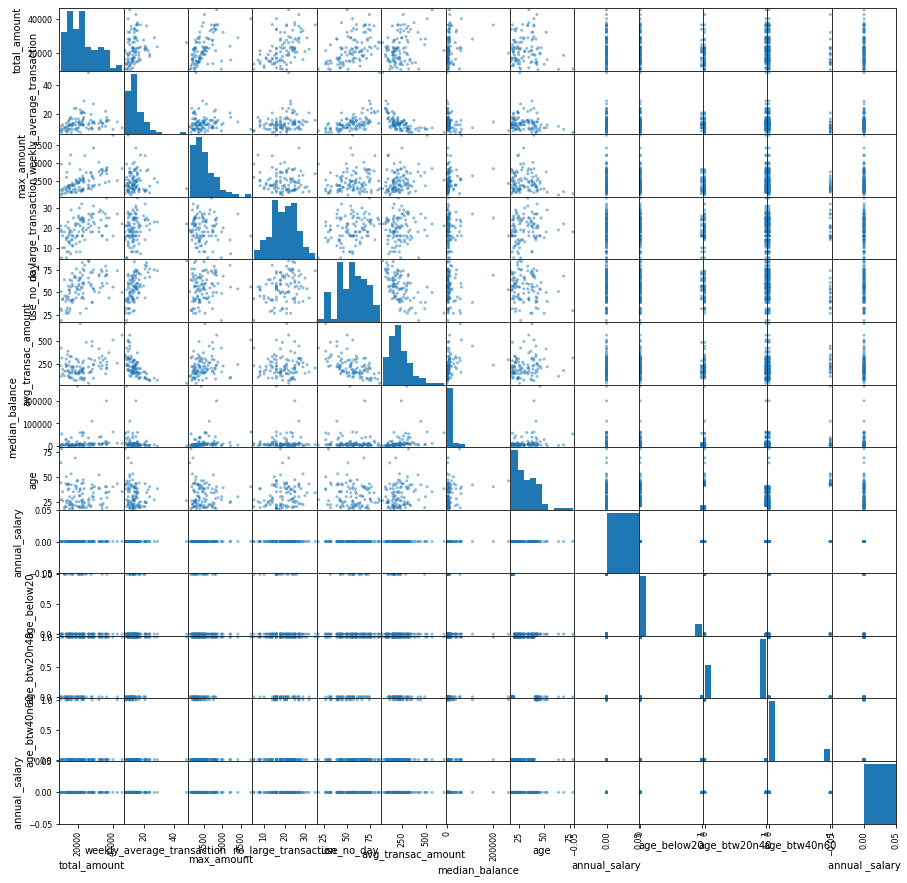

In [219]:
#explore correlations between annual salary and various customer attributes and features, visualise using scatter plot.

from pandas.plotting import scatter_matrix
scatter_matrix(df_cust_behaviour_summary, figsize=(15,15))
plt.show()

# Model Building

In [220]:
#start with the model that includes all the features created
# from sklearn.linear_model import LinearRegression, Lasso
import math
from sklearn import linear_model
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

In [104]:
#define dependent(y) and independent(x) variables
y= df_cust_behaviour_summary['annual_salary']
x=df_cust_behaviour_summary.drop(columns=['annual_salary', 'customer_id','state','gender'], axis=1)

#train test split 
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size= 0.2, random_state=42)

In [107]:
#check for shape
x_train.shape, y_train.shape, x_test.shape, y_test.shape


((80, 11), (80,), (20, 11), (20,))

In [108]:
#apply standard scaling to get optimized results

sc = StandardScaler()
x_train = sc.fit_transform(x_train)
x_test = sc.transform(x_test)

In [109]:
#create and train linear model 
LR = LinearRegression()
LR.fit(x_train, y_train)

LinearRegression()

In [110]:
#Use model to predict on test data
prediction = LR.predict(x_test)

In [111]:
#print model performance
print('Coefficients:', LR.coef_)
print('Intercept', LR.intercept_)
print('Mean squared error (MSE): %.2f' % mean_squared_error(y_test, prediction)) #%.2f=roundoff to 2 decimal places
print('Coefficient of determination (R^2): %.2f' % r2_score(y_test, prediction)) #equivalent of model.score()        #LR.score(x_test, y_test)
print(f'RMSE: %.2f'% math.sqrt(mean_squared_error(y_test,prediction)))

# print(f'adjusted R2 ={1-(1-r2_score(y_test,prediction))*((len(x_test)-1)/(len(x_test)-len(x_test[0])-1))}')
print(f'adjusted r2 ={1-(1-r2_score(y_test, prediction))*(len(x_test)-1)/(len(x_test)-len(x_test[0])-1)}')

Coefficients: [ 345761.17257798  -18198.25908356 -183847.03493676   19851.55248365
  -40511.41532484    2322.60819971  -56118.08602219  105979.57734275
  121392.88943692  141059.83062586   43600.04102329]
Intercept 605700.8430200892
Mean squared error (MSE): 31350906407.39
Coefficient of determination (R^2): 0.47
RMSE: 177061.87
adjusted r2 =-0.2582633535955581


Decision TreeRegressor

In [112]:
from sklearn.tree import DecisionTreeRegressor
from sklearn import tree
model = DecisionTreeRegressor(random_state=0)
model = model.fit(x_train, y_train)

In [113]:
tree_prediction = model.predict(x_test)

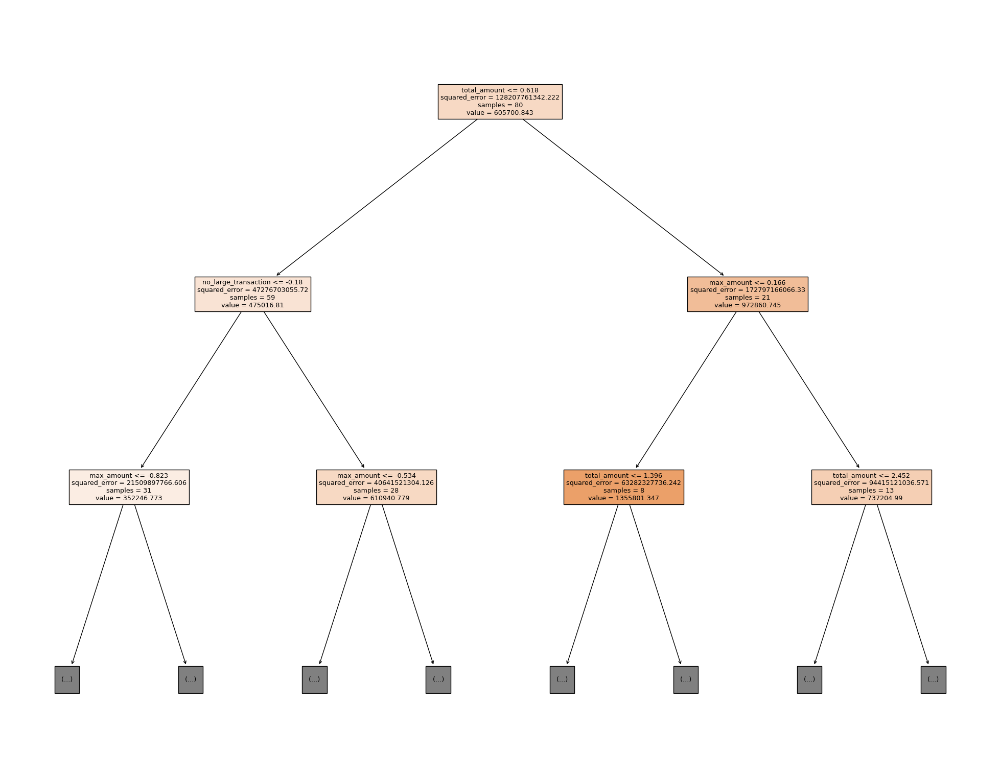

In [121]:
#plot tree
fig= plt.figure(figsize=(25,20), dpi=100)
gg = tree.plot_tree(model, filled=True, feature_names=x.columns, max_depth= 2)
plt.savefig('tree.pdf', bbox_inches='tight')

Measure Model Performance

In [115]:
#check accuracy
#compute test-set MSE
mse_tree = mean_squared_error(y_test, tree_prediction)
#compute test-set RMSE
rmse_tree = mse_tree**(1/2)
print(rmse_tree)

215501.1948422713


Conclusion and Recommendation

The model is not able to predict the annual salary of the customer accurately as shown by the model perfomance of the Regression Model and Decision Tree Regressor. More data is required to develop a more reliable model.